# FITS 다루기 그리고 plate solving


이 자료는 천체 관측 자료인 FITS 파일을 열어 관련 정보를 알아보는 방법을 설명합니다.

## 데이터 저장

### 데이터 저장 폴더 생성

데이터를 저장할 폴더를 "GSHS_Photometry" 라는 이름으로 생성해 보겠습니다.

* 만약 리눅스 시스템 이라면 shell 명령어로 가능한데, "!"를 붙이면 shell 명령어를 실행할 수 있습니다.
> !mkdir GSHS_Photometry

아래 코드를 실행하면 OS의 영향을 받지 않기 위하여 pathlib을 사용하여 폴더를 생성할 수 있습니다.

In [1]:
import os
from pathlib import Path
BASEPATH = Path("./")
save_dir_name = "GSHS_Photometry"
print(f"BASEPATH: {BASEPATH}")

if not (BASEPATH/save_dir_name).exists():
    os.mkdir(str(BASEPATH/save_dir_name))
    print (f"{str(BASEPATH/save_dir_name)} is created...")
else :
    print (f"{str(BASEPATH/save_dir_name)} is already exist...")

BASEPATH: .
GSHS_Photometry is created...


### FITS 파일 다운로드

나의 구글 드라이브에 저장된 CCD 관측 파일을 다운받아 보겠습니다.

GNU Wget은 HTTP 통신 또는 FTP 통신을 사용해 서버에서 파일 또는 콘텐츠를 다운로드할 때 사용하는 소프트웨어입니다. Wget의 특징은 여러 파일을 한 번에 다운로드하거나 웹 페이지의 링크를 순회하며 여러 콘텐츠를 자동으로 다운로드할 때 매우 편리합니다.

MS Windows에서는 별도로 설치를 해줘야 하며,
구글 코랩도 wget을을 지원해주니 아래 셀을 실행하면 자신의 [작업 영역]에 저장됩니다. 하지만 이 파일은 이 런타임이 재실행 될때는 삭제됨에 유의하시기 바랍니다.

아래 코드를 실행하면 여러분의 작업영역에 해당 파일을 저장할 것입니다.



In [2]:
fname0 = "46P-WIRTANEN_LIGHT_R_2018-12-13-17-46-15_60sec_FSQ106ED-x73_QSI683ws_-30c_2bin.fit"
fid0 = "1qJQdbmdeHg23sPdLKRGfPq93Sfo1HT_3"

fname1 = "IC434_Light_H_2019-10-08-09-38-54_900sec_GSON300_QSI683ws_-15C_1bin.fit"
fid1 = "1mCX_QfgbyskObkF9I_IDRk2oYWHOQjxs"

fname2 = "M13_Light_L_2021-06-04-13-10-16_090sec_TEC140x75_STL-11000M_-19C_1bin.fit"
fid2 = "1h15EMnhYb02KNhLkuqyUdR00fZV4xf3C"

# wget을 이용(나의 구굴드라이브에서 공유한 파일을 구글 코랩에서 사용할 경우)
!wget --no-check-certificate "https://docs.google.com/uc?export=download&id={fid0}" -O {save_dir_name}/{fname0}
!wget --no-check-certificate "https://docs.google.com/uc?export=download&id={fid1}" -O {save_dir_name}/{fname1}
!wget --no-check-certificate "https://docs.google.com/uc?export=download&id={fid2}" -O {save_dir_name}/{fname2}

# gdown을 이용(나의 구굴드라이브에서 공유한 파일을 다운로드)
#!gdown {fid} -O {save_dir_name}/{fname}

--2024-12-21 19:05:56--  https://docs.google.com/uc?export=download&id=1qJQdbmdeHg23sPdLKRGfPq93Sfo1HT_3
Resolving docs.google.com (docs.google.com)... 142.250.76.142, 2404:6800:400a:804::200e
Connecting to docs.google.com (docs.google.com)|142.250.76.142|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://drive.usercontent.google.com/download?id=1qJQdbmdeHg23sPdLKRGfPq93Sfo1HT_3&export=download [following]
--2024-12-21 19:05:57--  https://drive.usercontent.google.com/download?id=1qJQdbmdeHg23sPdLKRGfPq93Sfo1HT_3&export=download
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 142.250.206.193, 2404:6800:400a:813::2001
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|142.250.206.193|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4173120 (4.0M) [application/octet-stream]
Saving to: ‘GSHS_Photometry/46P-WIRTANEN_LIGHT_R_2018-12-13-17-46-15_60sec_FSQ106ED-x73_QSI683ws_-30c_2bi

### 데이터 확인

OS의 영향을 받지 않고 파이썬으로 확인하는 방법은 아래와 같이 하면 됩니다.

In [3]:
fpaths = sorted(list((BASEPATH/save_dir_name).glob('*.fit*')))
print(f"fpaths: {fpaths}")
print(f"len(fpaths): {len(fpaths)}")

fpaths: [PosixPath('GSHS_Photometry/46P-WIRTANEN_LIGHT_R_2018-12-13-17-46-15_60sec_FSQ106ED-x73_QSI683ws_-30c_2bin.fit'), PosixPath('GSHS_Photometry/IC434_Light_H_2019-10-08-09-38-54_900sec_GSON300_QSI683ws_-15C_1bin.fit'), PosixPath('GSHS_Photometry/M13_Light_L_2021-06-04-13-10-16_090sec_TEC140x75_STL-11000M_-19C_1bin.fit')]
len(fpaths): 3


In [4]:
fpaths[0]

PosixPath('GSHS_Photometry/46P-WIRTANEN_LIGHT_R_2018-12-13-17-46-15_60sec_FSQ106ED-x73_QSI683ws_-30c_2bin.fit')

##  FITS handling

### Read file

fits.open 함수로 fits 파일을 열 수 있습니다.


In [5]:
from astropy.io import fits

fpath = Path(fpaths[0])
print("fpath", (fpath))

hdul = fits.open(fpath)

print("type(hdul) :", type(hdul))
print("hdul :", hdul)

fpath GSHS_Photometry/46P-WIRTANEN_LIGHT_R_2018-12-13-17-46-15_60sec_FSQ106ED-x73_QSI683ws_-30c_2bin.fit
type(hdul) : <class 'astropy.io.fits.hdu.hdulist.HDUList'>
hdul : [<astropy.io.fits.hdu.image.PrimaryHDU object at 0x72b422b7c830>]


HDUList 이므로 그 길이를 알아보자.

In [6]:
print("len(hdul) :", len(hdul))

len(hdul) : 1


dir 함수를 이용하여 객체에 사용할수 있는 mathod를 알아보자.

In [7]:
print("dir(hdul) :", dir(hdul))
print("dir(hdul[0]) :", dir(hdul[0]))

dir(hdul) : ['__add__', '__class__', '__class_getitem__', '__contains__', '__copy__', '__deepcopy__', '__delattr__', '__delitem__', '__dict__', '__dir__', '__doc__', '__enter__', '__eq__', '__exit__', '__format__', '__ge__', '__getattribute__', '__getitem__', '__getstate__', '__gt__', '__hash__', '__iadd__', '__imul__', '__init__', '__init_subclass__', '__iter__', '__le__', '__len__', '__lt__', '__module__', '__mul__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__reversed__', '__rmul__', '__setattr__', '__setitem__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_data', '_file', '_flush_resize', '_flush_update', '_in_read_next_hdu', '_open_kwargs', '_positive_index_of', '_read_all', '_read_next_hdu', '_readfrom', '_resize', '_truncate', '_try_while_unread_hdus', '_verify', '_wasresized', 'append', 'clear', 'close', 'copy', 'count', 'extend', 'fileinfo', 'filename', 'flush', 'fromfile', 'fromstring', 'index', 'index_of', 'info', 'insert', 'pop', 'rea

### header

In [8]:
print("type(hdul[0].hedaer) :", type(hdul[0].header))
#print("hdul[0].hedaer :", hdul[0].header)
hdul[0].header

type(hdul[0].hedaer) : <class 'astropy.io.fits.header.Header'>


SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                   16 / number of bits per data pixel                  
NAXIS   =                    2 / number of data axes                            
NAXIS1  =                 1663 / length of data axis 1                          
NAXIS2  =                 1252 / length of data axis 2                          
EXTEND  =                    T / FITS dataset may contain extensions            
BSCALE  =                    1 / default scaling factor                         
BZERO   =                32768 / offset data range to that of unsigned short    
PROGRAM = 'PixInsight 1.8.8-7' / Software that created this HDU                 
COLORSPC= 'Grayscale'          / PCL: Color space                               
RESOLUTN=                  72. / PCL: Resolution in pixels per resolution unit  
RESOUNIT= 'inch    '           / PCL: Resolution unit                           
THUMBIMG= 'Thumbnail'       

header는 key와 value가 들어 있습니다.

In [9]:
print("hdul[0].hedaer['DATE-OBS'] :", hdul[0].header['DATE-OBS'])
print("type(hdul[0].hedaer['DATE-OBS']) :", type(hdul[0].header['DATE-OBS']))

hdul[0].hedaer['DATE-OBS'] : 2018-12-13T17:46:15.000
type(hdul[0].hedaer['DATE-OBS']) : <class 'str'>


In [10]:
import astropy.units as u
type(hdul[0].header['DEC'])

hdul[0].header['DEC']

11.2265728979271

### data

관측 자료는 numpy.ndarray 형태로 들어 있음을 알 수 있습니다.

In [11]:
print("type(hdul[0].data) :", type(hdul[0].data))
print("hdul[0].data.dtype :", hdul[0].data.dtype)
print("hdul[0].data.shape :", hdul[0].data.shape)
print("hdul[0].data :", hdul[0].data)

type(hdul[0].data) : <class 'numpy.ndarray'>
hdul[0].data.dtype : uint16
hdul[0].data.shape : (1252, 1663)
hdul[0].data : [[33368 34170 33854 ... 36466 36010 36280]
 [33296 33358 33634 ... 36270 36458 36298]
 [33778 33790 33436 ... 36250 36342 36420]
 ...
 [33136 32798 32880 ... 34380 34958 35132]
 [33104 33602 33616 ... 34602 35266 34674]
 [32786 33022 32562 ... 35194 34450 35042]]


## Display FITS file

matplotlib을 이용하면 numpy.ndarray를 화면에 디스플레이할 수 있습니다.

### 간단히 한개 파일 display 하기

plt.imshow 함수를 이용하면 쉽게 2d array를 display 할 수 있습니다.

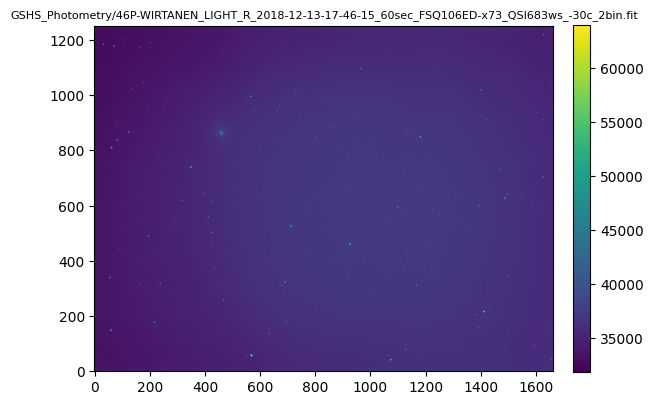

In [12]:
import numpy as np
import matplotlib.pyplot as plt

im = plt.imshow(hdul[0].data,
                origin='lower',
                )

plt.title(f'{str(fpaths[0])}', fontsize=8)
plt.colorbar(im, fraction=0.035, pad=0.04)
plt.show()

### image slicing

numpy.ndarray는 다음과 같이 슬라이싱을 할 수 있습니다.


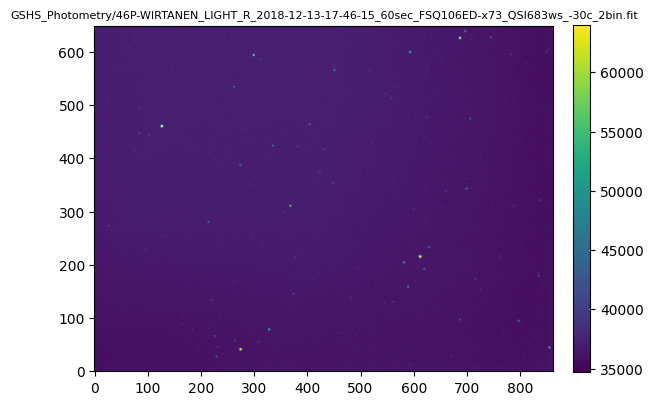

In [13]:
im = plt.imshow(hdul[0].data[0:650, 800:],
                origin='lower',
                )

plt.title(f'{str(fpaths[0])}', fontsize=8)
plt.colorbar(im, fraction=0.035, pad=0.04)
plt.show()

### ImageNormalize

ImageNormalize는 이미지의 픽셀 값을 특정 범위로 조정하고, 이를 통해 이미지의 대비를 조절하여 시각화를 향상시키는 데 사용되는 Astropy 라이브러리의 클래스입니다.

* 픽셀 값 정규화: 이미지의 픽셀 값을 최소값과 최대값 사이의 특정 범위로 조정합니다. 이를 통해 이미지의 전체적인 밝기를 조절하고, 특정 영역을 강조할 수 있습니다.
* 스트레칭: 정규화된 픽셀 값에 스트레칭 함수를 적용하여 대비를 조절합니다. 다양한 스트레칭 함수를 제공하여 이미지의 특성에 맞게 시각화를 최적화할 수 있습니다.



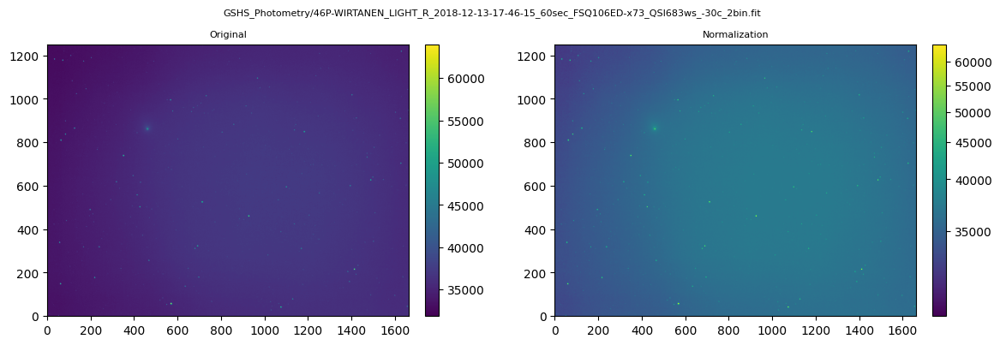

In [14]:
from astropy.visualization import (MinMaxInterval, SqrtStretch,
                                   ImageNormalize)

# Create an ImageNormalize object
norm = ImageNormalize(hdul[0].data, interval=MinMaxInterval(),
                      stretch=SqrtStretch())

fig, axs = plt.subplots(1, 2, figsize=(12, 4),
                       sharex=False, sharey=False, gridspec_kw=None)

im1 = axs[0].imshow(hdul[0].data,
                origin='lower',
                )
axs[0].set_title('Original', fontsize=8)

im2 = axs[1].imshow(hdul[0].data,
                origin='lower',
                norm=norm,
                )
axs[1].set_title('Normalization', fontsize=8)

fig.suptitle(f'{str(fpaths[0])}', fontsize=8)
fig.colorbar(im1, ax = axs[0], fraction=0.035, pad=0.04)
fig.colorbar(im2, ax = axs[1], fraction=0.035, pad=0.04)
plt.tight_layout()

### zimshow 함수

이를 함수로 만들어 쉽게 이용해 보겠습니다. 앞으로는 fits 파일을 display 할때마다 아래의 함수를 사용하도록 하겠습니다.

In [15]:
from warnings import warn
from astropy.visualization import (
    ImageNormalize,
    LinearStretch,
    ZScaleInterval,
    simple_norm,
)

def znorm(image, stretch=LinearStretch(), **kwargs):
    return ImageNormalize(image, interval=ZScaleInterval(**kwargs), stretch=stretch)

def zimshow(
    ax,
    image,
    stretch=LinearStretch(),
    cmap=None,
    origin="lower",
    zscale_kw={},
    **kwargs
    ):
    im = ax.imshow(
        image,
        norm=znorm(image, stretch=stretch, **zscale_kw),
        origin=origin,
        cmap=cmap,
        **kwargs
    )
    return im

def norm_imshow(
    ax,
    data,
    origin="lower",
    stretch="linear",
    power=1.0,
    asinh_a=0.1,
    min_cut=None,
    max_cut=None,
    min_percent=None,
    max_percent=None,
    percent=None,
    clip=True,
    log_a=1000,
    invalid=-1.0,
    zscale=False,
    vmin=None,
    vmax=None,
    **kwargs
):
    """Do normalization and do imshow"""
    if vmin is not None and min_cut is not None:
        warn("vmin will override min_cut.")

    if vmax is not None and max_cut is not None:
        warn("vmax will override max_cut.")

    if zscale:
        zs = ImageNormalize(data, interval=ZScaleInterval())
        min_cut = vmin = zs.vmin
        max_cut = vmax = zs.vmax

    if vmin is not None or vmax is not None:
        im = ax.imshow(data, origin=origin, vmin=vmin, vmax=vmax, **kwargs)
    else:
        im = ax.imshow(
            data,
            origin=origin,
            norm=simple_norm(
                data=data,
                stretch=stretch,
                power=power,
                asinh_a=asinh_a,
                min_cut=min_cut,
                max_cut=max_cut,
                min_percent=min_percent,
                max_percent=max_percent,
                percent=percent,
                clip=clip,
                log_a=log_a,
                invalid=invalid
            ),
            **kwargs)
    return im

### plt.subplots 두개 파일 display

2개 이상의 subplot을 그리는 방법은 여러가지가 있습니다. 아래에 하나의 예시를 보여줍니다.

fpaths[0] GSHS_Photometry/46P-WIRTANEN_LIGHT_R_2018-12-13-17-46-15_60sec_FSQ106ED-x73_QSI683ws_-30c_2bin.fit
fpaths[1] GSHS_Photometry/IC434_Light_H_2019-10-08-09-38-54_900sec_GSON300_QSI683ws_-15C_1bin.fit


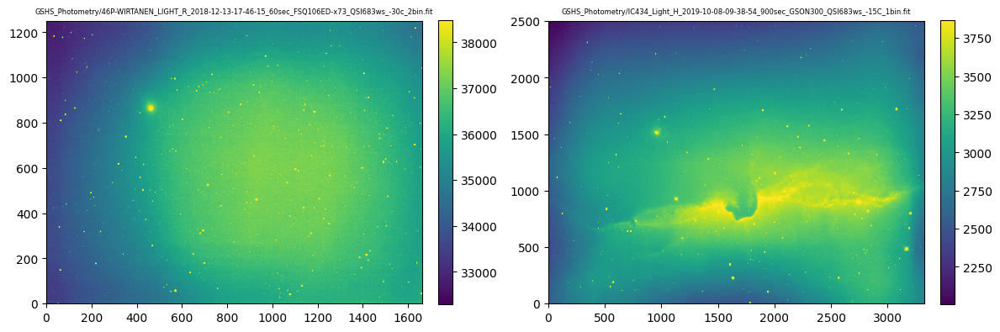

In [16]:
print("fpaths[0]", (fpaths[0]))
hdul0 = fits.open(str(fpaths[0]))

print("fpaths[1]", (fpaths[1]))
hdul1 = fits.open(str(fpaths[1]))

fig, axs = plt.subplots(1, 2, figsize=(12, 4),
                       sharex=False, sharey=False, gridspec_kw=None)

im0 = zimshow(axs[0], hdul0[0].data,
                origin='lower',
                )
axs[0].set_title(f'{str(fpaths[0])}', fontsize=6)

im1 = zimshow(axs[1], hdul1[0].data,
                origin='lower',
                )
axs[1].set_title(f'{str(fpaths[1])}', fontsize=6)

fig.colorbar(im0, ax = axs[0], fraction=0.035, pad=0.04)
fig.colorbar(im1, ax = axs[1], fraction=0.035, pad=0.04)

plt.tight_layout()

### colormap

다양한 컬러맵을 사용할 수 있습니다.


fpaths[2] GSHS_Photometry/M13_Light_L_2021-06-04-13-10-16_090sec_TEC140x75_STL-11000M_-19C_1bin.fit


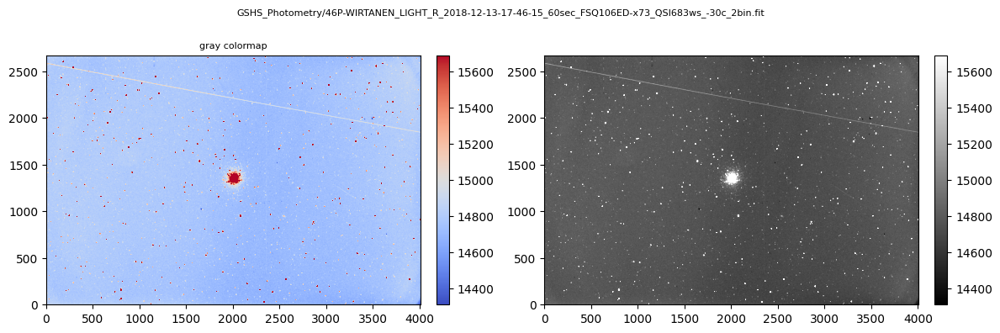

In [17]:
print("fpaths[2]", (fpaths[2]))
hdul2 = fits.open(str(fpaths[2]))

fig, axs = plt.subplots(1, 2, figsize=(12, 4),
                       sharex=False, sharey=False, gridspec_kw=None)

im0 = zimshow(axs[0], hdul2[0].data,
                origin='lower',
                cmap='coolwarm',
                )
axs[0].set_title('coolwarm colormap', fontsize=8)

im1 = zimshow(axs[1], hdul2[0].data,
                origin='lower',
                cmap='gray',
                )
axs[0].set_title('gray colormap', fontsize=8)

fig.suptitle(f'{str(fpaths[0])}', fontsize=8)
fig.colorbar(im0, ax = axs[0], fraction=0.031, pad=0.04)
fig.colorbar(im1, ax = axs[1], fraction=0.031, pad=0.04)
plt.tight_layout()

## plate solving

### check plate solve 함수 만들기

fits header의 keywords 중에서 plate solving과 관련 있는 keywords를 체크하여 plate solving 여부를 판단하는 함수를 만들어 보자.


In [18]:
def checkPSolve(fpath,
                    **kwargs,
                    ):
    """
    Parameters
    ----------
    fpath : path-like
        The path to the original FITS file.

    return
    ----------
    SOLVE, ASTAP, LOCAL :  bool, bool, bool

    """

    fpath = Path(fpath)

    hdul = fits.open(fpath)
    PSKeys = ["CRVAL1", "CRVAL2", "CRPIX1", "CRPIX2",
              "CD1_1", "CD1_2", "CD2_1", "CD2_2",
              "A_0_0", "A_0_1", "A_1_0","A_1_1",
              "PC1_1", "PC1_2", "PC2_1", "PC2_2",
              ]

    chk = 0
    SOLVE = False
    ASTAP = False
    LOCAL = False

    for PSKey in PSKeys :
        if PSKey in hdul[0].header :
            chk += 1
    if chk > 5 :
        SOLVE = True
        LOCAL = False
        ASTAP = False
        try :
            for comment in hdul[0].header["COMMENT"]:
                if "scale:" in comment :
                    LOCAL = True
        except :
            LOCAL = False

        if "PLTSOLVD" in hdul[0].header:
            try :
                ASTAP = hdul[0].header["PLTSOLVD"]
            except :
                ASTAP = False
    else :
        SOLVE = False
        ASTAP = False
        LOCAL = False
    hdul.close()

    return SOLVE, ASTAP, LOCAL

### check solving

아래와 같이 파일이 plate solving이 되었는지 아닌지 확인할 수 있습니다.

In [19]:
SOLVE, ASTAP, LOCAL = checkPSolve(str(fpaths[0]))
print("SOLVE, ASTAP, LOCAL :", SOLVE, ASTAP, LOCAL)
SOLVE, ASTAP, LOCAL = checkPSolve(str(fpaths[1]))
print("SOLVE, ASTAP, LOCALE :", SOLVE, ASTAP, LOCAL)
SOLVE, ASTAP, LOCALE = checkPSolve(str(fpaths[2]))
print("SOLVE, ASTAP, LOCALE :", SOLVE, ASTAP, LOCAL)

SOLVE, ASTAP, LOCAL : False False False
SOLVE, ASTAP, LOCALE : False False False
SOLVE, ASTAP, LOCALE : True True False


## astrometry solving





### apstrometry 연결

[nova.astrometry.net](https://nova.astrometry.net/html/) 으로부터 api key를 이용하여 연결합니다. api key는 회원가입을 하고 로그인을 하면 자신의 api key를 볼 수 있습니다.


In [20]:
from astroquery.astrometry_net import AstrometryNet

ast = AstrometryNet()

# get from nova.astrometry.net
ast.api_key = 'bldvwzzuvktnwfph' # must be changed...

### file solving

아래와 같이 파일을 업로드하여 plate solving을 시도해 볼 수 있습니다.

In [21]:
# print(fpaths[0])
# SOLVE, ASTAP, LOCAL = checkPSolve(str(fpaths[0]))
# print("SOLVE, ASTAP, LOCAL :", SOLVE, ASTAP, LOCAL)
# print("before solving :", hdul[0].header)

# solve_timeout = 600
# wcs_header = ast.solve_from_image(str(fpaths[0]),
#                         force_image_upload=True,
#                         solve_timeout = solve_timeout,
#                         )
# print("after solving :", wcs_header)
# wcs_header

### header update

fits header에 plate solving 결과를 저장하고 업데이트를 합니다.

In [22]:
# if wcs_header :
#     with fits.open(str(fpaths[0]), mode='update') as hdul:
#         for card in wcs_header :
#             try:
#                 print(card, wcs_header[card], wcs_header.comments[card])
#                 hdul[0].header.set(card, wcs_header[card], wcs_header.comments[card])
#             except :
#                 print(card)
#         hdul.flush

#     print(str(fpaths[0])+" is updated...")

#     SOLVE, ASTAP, LOCAL = checkPSolve(str(fpaths[0]))
#     print("SOLVE, ASTAP, LOCAL :", SOLVE, ASTAP, LOCAL)

### plate solving 함수 만들기

In [23]:
#########################################
# AstrometrySolver
#########################################
def AstrometrySolver(fpath,
                    ast = AstrometryNet(),
                    api_key = ast.api_key,
                    submission_id = None,
                    solve_timeout = 600,
                    **kwargs,
                    ):
    """
    Parameters
    ----------
    fpath : path-like
        The path to the original FITS file.

    return
    ----------
    SOLVE, ASTAP, LOCAL :  bool, bool, bool
    """

    fpath = Path(fpath)
    hdul = fits.open(fpath)
    print(f"check plate solving : {fpath.name}")
    SOLVE, ASTAP, LOCAL = checkPSolve(str(fpath))
    print("SOLVE, ASTAP, LOCAL:", SOLVE, ASTAP, LOCAL)

    if SOLVE :
        print(f"{fpath.name} is already solved...")
    else :
        try_again = True

        try :
            while try_again:
                try:
                    if not submission_id:
                        wcs_header = ast.solve_from_image(str(fpath),
                                            force_image_upload=True,
                                            solve_timeout = solve_timeout,
                                            submission_id=submission_id)
                    else:
                        wcs_header = ast.monitor_submission(submission_id,
                                                            solve_timeout = solve_timeout)
                except TimeoutError as e:
                    submission_id = e.args[1]
                else:
                    # got a result, so terminate
                    try_again = False

            if not wcs_header:
                # Code to execute when solve fails
                print("fits file solving failure...")

            else:
                # Code to execute when solve succeeds
                print("fits file solved successfully...")

                with fits.open(str(fpath), mode='update') as hdul:
                    for card in wcs_header :
                        try:
                            print(card, wcs_header[card], wcs_header.comments[card])
                            hdul[0].header.set(card, wcs_header[card], wcs_header.comments[card])
                        except :
                            print(card)
                    hdul.flush

                print(str(fpath)+" is created...")

        except Exception as err:
            print("Err :", err)

### plate solving 하기


In [24]:
AstrometrySolver(fpaths[0])
AstrometrySolver(fpaths[1])
AstrometrySolver(fpaths[2])

check plate solving : 46P-WIRTANEN_LIGHT_R_2018-12-13-17-46-15_60sec_FSQ106ED-x73_QSI683ws_-30c_2bin.fit
SOLVE, ASTAP, LOCAL: False False False
Solving..................fits file solved successfully...
SIMPLE True Standard FITS file
BITPIX 8 ASCII or bytes array
NAXIS 0 Minimal header
EXTEND True There may be FITS ext
WCSAXES 2 no comment
CTYPE1 RA---TAN-SIP TAN (gnomic) projection + SIP distortions
CTYPE2 DEC--TAN-SIP TAN (gnomic) projection + SIP distortions
EQUINOX 2000.0 Equatorial coordinates definition (yr)
LONPOLE 180.0 no comment
LATPOLE 0.0 no comment
CRVAL1 54.035799251 RA  of reference point
CRVAL2 11.2893666604 DEC of reference point
CRPIX1 794.279380798 X reference pixel
CRPIX2 642.909606934 Y reference pixel
CUNIT1 deg X pixel scale units
CUNIT2 deg Y pixel scale units
CD1_1 0.000169237518935 Transformation matrix
CD1_2 0.00158582298194 no comment
CD2_1 -0.00158539734871 no comment
CD2_2 0.000170640321483 no comment
IMAGEW 1663 Image width,  in pixels.
IMAGEH 1252 Image h

In [25]:
SOLVE, ASTAP, LOCAL = checkPSolve(str(fpaths[0]))
print("SOLVE, ASTAP, LOCAL :", SOLVE, ASTAP, LOCAL)
SOLVE, ASTAP, LOCAL = checkPSolve(str(fpaths[1]))
print("SOLVE, ASTAP, LOCAL :", SOLVE, ASTAP, LOCAL)
SOLVE, ASTAP, LOCAL = checkPSolve(str(fpaths[2]))
print("SOLVE, ASTAP, LOCAL :", SOLVE, ASTAP, LOCAL)

SOLVE, ASTAP, LOCAL : True False False
SOLVE, ASTAP, LOCAL : True False False
SOLVE, ASTAP, LOCAL : True True False


###(과제)

아래의 예제 파일을 위의 AstrometrySolver 함수를 사용하여 astrometry api key를 이용하여 plate solving을 해 봅시다.

파일 링크: https://drive.google.com/file/d/1ShQAM0a28vFvh6-Ij00SZfjZLMVIiBe0/view?usp=drive_link

* 원본 파일명 : KLEOPATRA_Light_r_2022-11-02-12-22-46_100sec_RiLA600_STX-16803_-20C_2bin.fit

In [26]:
#(과제) 아래 코딩을 완성하여 제출하시오.







## Fits file display using WCS

먼저 세 파일을 열어서 hdul0, hdul1, hdul2 로 저장해 두고 각 헤더를 살펴보자.


In [27]:
print("fpaths[0] :", fpaths[0])
hdul0 = fits.open(str(fpaths[0]))
hdul0[0].header

fpaths[0] : GSHS_Photometry/46P-WIRTANEN_LIGHT_R_2018-12-13-17-46-15_60sec_FSQ106ED-x73_QSI683ws_-30c_2bin.fit


SIMPLE  =                    T / Standard FITS file                             
BITPIX  =                   16 / ASCII or bytes array                           
NAXIS   =                    2 / Minimal header                                 
NAXIS1  =                 1663 / length of data axis 1                          
NAXIS2  =                 1252 / length of data axis 2                          
EXTEND  =                    T / There may be FITS ext                          
BSCALE  =                    1 / default scaling factor                         
BZERO   =                32768 / offset data range to that of unsigned short    
PROGRAM = 'PixInsight 1.8.8-7' / Software that created this HDU                 
COLORSPC= 'Grayscale'          / PCL: Color space                               
RESOLUTN=                  72. / PCL: Resolution in pixels per resolution unit  
RESOUNIT= 'inch    '           / PCL: Resolution unit                           
THUMBIMG= 'Thumbnail'       

In [28]:
print("fpaths[1] :", fpaths[1])
hdul1 = fits.open(str(fpaths[1]))
hdul1[0].header

fpaths[1] : GSHS_Photometry/IC434_Light_H_2019-10-08-09-38-54_900sec_GSON300_QSI683ws_-15C_1bin.fit


SIMPLE  =                    T / Standard FITS file                             
BITPIX  =                   16 / ASCII or bytes array                           
NAXIS   =                    2 / Minimal header                                 
NAXIS1  =                 3326 / length of data axis 1                          
NAXIS2  =                 2504 / length of data axis 2                          
EXTEND  =                    T / There may be FITS ext                          
BSCALE  =                    1 / default scaling factor                         
BZERO   =                32768 / offset data range to that of unsigned short    
PROGRAM = 'PixInsight 1.8.8-7' / Software that created this HDU                 
COLORSPC= 'Grayscale'          / PCL: Color space                               
RESOLUTN=                  72. / PCL: Resolution in pixels per resolution unit  
RESOUNIT= 'inch    '           / PCL: Resolution unit                           
THUMBIMG= 'Thumbnail'       

In [29]:
print("fpaths[2] :", fpaths[2])
hdul2 = fits.open(str(fpaths[2]))
hdul2[0].header

fpaths[2] : GSHS_Photometry/M13_Light_L_2021-06-04-13-10-16_090sec_TEC140x75_STL-11000M_-19C_1bin.fit


SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                   16 / number of bits per data pixel                  
NAXIS   =                    2 / number of data axes                            
NAXIS1  =                 4008 / length of data axis 1                          
NAXIS2  =                 2672 / length of data axis 2                          
EXTEND  =                    T / FITS dataset may contain extensions            
BSCALE  =                    1 / default scaling factor                         
BZERO   =                32768 / offset data range to that of unsigned short    
PROGRAM = 'PixInsight 1.8.9-1' / Software that created this HDU                 
COLORSPC= 'Grayscale'          / PCL: Color space                               
RESOLUTN=                  72. / PCL: Resolution in pixels per resolution unit  
RESOUNIT= 'inch    '           / PCL: Resolution unit                           
THUMBIMG= 'Thumbnail'       

### wcs 만들기

plate solving이 되고 나면 [astropy.wcs](https://docs.astropy.org/en/stable/visualization/wcsaxes/index.html)의 WCS(World coordnate system)를 wcs class를 만들 수 있습니다.

In [30]:
from astropy import units as u
from astropy.time import Time
from astropy.coordinates import SkyCoord
from astropy.wcs import WCS

wcs0 = WCS(hdul0[0].header)
wcs1 = WCS(hdul1[0].header)
wcs2 = WCS(hdul2[0].header)

Set MJD-END to 58465.741146 from DATE-END'. [astropy.wcs.wcs]
Set MJD-END to 58764.412431 from DATE-END'. [astropy.wcs.wcs]
Set OBSGEO-Y to  4073101.932 from OBSGEO-[LBH].
Set OBSGEO-Z to  3817455.773 from OBSGEO-[LBH]'. [astropy.wcs.wcs]


wcs class에는 좌표 변환 변수들이 저장되어 있음을 알 수 있습니다.

In [31]:
print("type(wcs0) :", type(wcs0))
print("dir(wcs0) :", dir(wcs0))
print("wcs0 :", wcs0)
print("wcs1 :", wcs1)
print("wcs2 :", wcs2)
print("wcs0.world_axis_physical_types :", wcs0.world_axis_physical_types)
print("wcs1.world_axis_physical_types :", wcs1.world_axis_physical_types)
wcs0.wcs.print_contents()
wcs0.wcs.name

type(wcs0) : <class 'astropy.wcs.wcs.WCS'>
dir(wcs0) : ['__abstractmethods__', '__class__', '__copy__', '__deepcopy__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getitem__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__iter__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_abc_impl', '_all_pix2world', '_all_world2pix', '_array_converter', '_as_mpl_axes', '_denormalize_sky', '_det2im', '_fix_ctype', '_fix_pre2012_scamp_tpv', '_fix_scamp', '_get_components_and_classes', '_get_naxis', '_init_kwargs', '_naxis', '_normalize_sky', '_out_of_bounds_to_nan', '_p4_pix2foc', '_pix2foc', '_pixel_bounds', '_read_d2im_old_format', '_read_det2im_kw', '_read_distortion_kw', '_read_sip_kw', '_remove_sip_kw', '_write_det2im', '_write_distortion_kw', '_write_sip_kw', 'all_pix2world', 'a

''

            127.000000       37.566944       UNDEFINED
   obsorbit: UNDEFINED
    radesys: "FK5"
    equinox:   2000.000000000
    specsys: UNDEFINED
    ssysobs: UNDEFINED
    velosys: UNDEFINED
    zsource: UNDEFINED
    ssyssrc: UNDEFINED
    velangl: UNDEFINED
        aux: 0x0
       ntab: 0
        tab: 0x0
       nwtb: 0
        wtb: 0x0
     lngtyp: "RA"
     lattyp: "DEC"
        lng: 0
        lat: 1
       spec: -1
       time: -1
   cubeface: -1
     chksum:  1011276325
      types: 0x2cd8d0e0
            2200 2201
        err: 0x0
        lin: (see below)
        cel: (see below)
        spc: (see below)
     m_flag: 137
    m_naxis: 2
    m_crpix: 0x2cd82450  (= crpix)
       m_pc: 0x2cc811f0  (= pc)
    m_cdelt: 0x2cb99ed0  (= cdelt)
    m_crval: 0x2cdad940  (= crval)
    m_cunit: 0x2cd6b520  (= cunit)
    m_ctype: 0x2cd6b5c0  (= ctype)
       m_pv: 0x0  (= pv)
       m_ps: 0x0  (= ps)
       m_cd: 0x2cc0ff80  (= cd)
    m_crota: 0x2cd73fd0  (= crota)

    m_colax: 0x2cd7

### display fits file with WCS

matplotlib에서 projection 옵션을 사용하여 각 픽셀 좌표를 천구 좌표롤 나타낼 수 있습니다.

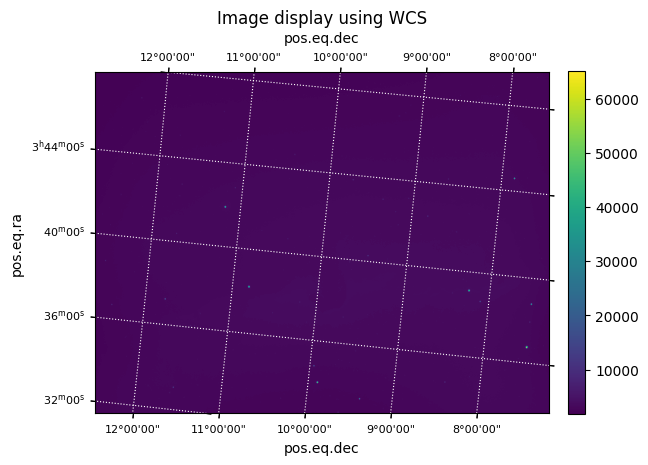

dir(ax.coords) : ['__class__', '__contains__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getitem__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__iter__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_aliases', '_as_table', '_axes', '_coords', '_transform', 'frame', 'get_coord_range', 'grid', 'set_visible']
ax.coords.set_visible : <bound method CoordinatesMap.set_visible of <CoordinatesMap with 2 world coordinates:

  index           aliases              type   unit    wrap   format_unit visible
  ----- --------------------------- --------- ---- --------- ----------- -------
      0   pos.eq.ra ra---tan-sip ra longitude  deg 360.0 deg   hourangle     yes
      1 pos.eq.dec dec--tan-sip dec  latitude  deg      None         deg     yes

>>
ax.coords.frame : RectangularF

In [32]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1, projection=wcs0)
im = plt.imshow(hdul1[0].data, origin='lower', cmap="viridis",)

# ax.coords['ra'].set_ticks(spacing=5. * u.arcmin)
# ax.coords['dec'].set_ticks(spacing=5. * u.arcmin)
ax.coords['ra'].set_auto_axislabel(True)
ax.coords['dec'].set_auto_axislabel(True)
# ax.coords['ra'].set_ticks_position('lb')
# ax.coords['dec'].set_ticks_position('lb')
ax.coords['ra'].set_ticklabel_visible(True)
ax.coords['ra'].set_ticklabel(size=8)
ax.coords['dec'].set_ticklabel(size=8)
ax.coords['ra'].set_major_formatter('hh:mm:ss')
ax.coords['dec'].set_major_formatter('dd:mm:ss')
ax.coords['ra'].set_ticklabel_position('l') #left, right, bottom, top
ax.coords['dec'].set_ticklabel_position('bt') #left, right, bottom, top

ax.grid(color='white', ls='dotted')

# overlay = ax.get_coords_overlay('icrs')
# overlay.grid(color='white', ls='dotted')

plt.title('Image display using WCS', fontsize=12, pad=35)
fig.colorbar(im, fraction=0.035, pad=0.04)
plt.tight_layout(pad=0.4, w_pad=1, h_pad=1.0)
plt.show()

print("dir(ax.coords) :", dir(ax.coords))
# print("ax.coords.get_coord_range :", ax.coords.get_coord_range)
print("ax.coords.set_visible :", ax.coords.set_visible)
print("ax.coords.frame :", ax.coords.frame)

### some error

아래 파일에서는 axislabel, ticklatel 이 제대로 표출되지 않는데 그 이유는 아직 모르겠다.

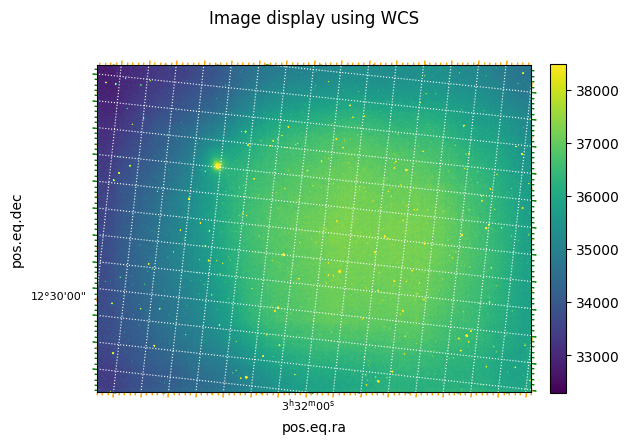

dir(axs.coords) : ['__class__', '__contains__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getitem__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__iter__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_aliases', '_as_table', '_axes', '_coords', '_transform', 'frame', 'get_coord_range', 'grid', 'set_visible']
axs.coords.set_visible : <bound method CoordinatesMap.set_visible of <CoordinatesMap with 2 world coordinates:

  index           aliases              type   unit    wrap   format_unit visible
  ----- --------------------------- --------- ---- --------- ----------- -------
      0   pos.eq.ra ra---tan-sip ra longitude  deg 360.0 deg   hourangle     yes
      1 pos.eq.dec dec--tan-sip dec  latitude  deg      None         deg     yes

>>
axs.coords.frame : Rectangul

In [33]:
fig, axs = plt.subplots(1, 1,
                        sharex=False, sharey=False, gridspec_kw=None,
                        subplot_kw={'projection': wcs0},
                        )

im = zimshow(axs, hdul0[0].data,
                origin='lower',
                cmap="viridis",
             )

axs.coords['ra'].set_ticks(spacing=10 * u.arcmin, color='green')
axs.coords['dec'].set_ticks(spacing=10 * u.arcmin, color='orange')
axs.coords['ra'].display_minor_ticks(True)
axs.coords['dec'].display_minor_ticks(True)
axs.coords['ra'].set_ticklabel_visible(True)
axs.coords['dec'].set_ticklabel_visible(True)
axs.coords['ra'].set_ticklabel(size=8)
axs.coords['dec'].set_ticklabel(size=8)
# axs.coords['ra'].set_minor_frequency(10)
# axs.coords['dec'].set_minor_frequency(10)
axs.coords['ra'].set_ticklabel_position('b') #left, right, bottom, top
axs.coords['dec'].set_ticklabel_position('l') #left, right, bottom, top
axs.coords['ra'].set_major_formatter('hh:mm:ss')
axs.coords['dec'].set_major_formatter('dd:mm:ss')
# axs.coords['ra'].set_auto_axislabel(True)
# axs.coords['dec'].set_auto_axislabel(True)
# axs.coords['ra'].set_axislabel('Right Ascension')
# axs.coords['dec'].set_axislabel('Declination')
axs.coords['ra'].set_axislabel_position('b') #left, right, bottom, top
axs.coords['dec'].set_axislabel_position('l') #left, right, bottom, top

axs.grid(color='white', ls='dotted')

axs.set_title('Image display using WCS', fontsize=12, pad=30)

fig.colorbar(im, fraction=0.035, pad=0.04)

plt.tight_layout()
plt.show()

print("dir(axs.coords) :", dir(axs.coords))
# print("axs.coords.get_coord_range :", axs.coords.get_coord_range)
print("axs.coords.set_visible :", axs.coords.set_visible)
print("axs.coords.frame :", axs.coords.frame)

아래 파일에서는 axislabel, ticklatel 이 제대로 표출되지 않는데 그 이유는 아직 모르겠다.

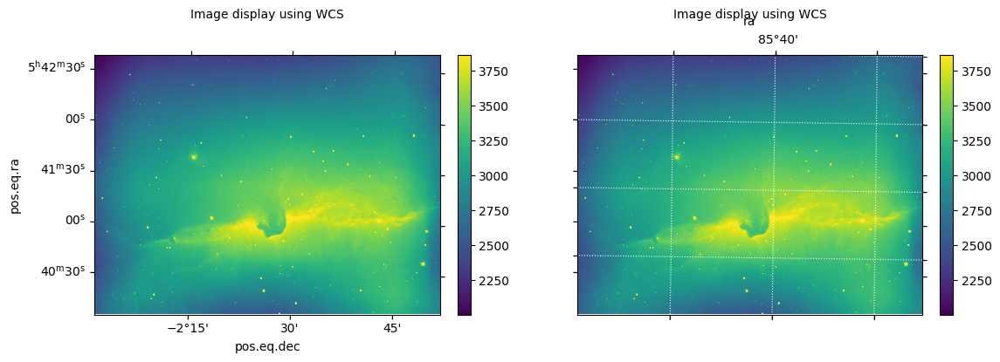

dir(axs[0].coords) : ['__class__', '__contains__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getitem__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__iter__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_aliases', '_as_table', '_axes', '_coords', '_transform', 'frame', 'get_coord_range', 'grid', 'set_visible']
axs[0].coords.set_visible : <bound method CoordinatesMap.set_visible of <CoordinatesMap with 2 world coordinates:

  index           aliases              type   unit    wrap   format_unit visible
  ----- --------------------------- --------- ---- --------- ----------- -------
      0   pos.eq.ra ra---tan-sip ra longitude  deg 360.0 deg   hourangle     yes
      1 pos.eq.dec dec--tan-sip dec  latitude  deg      None         deg     yes

>>
axs[0].coords.frame : 

In [34]:
fig, axs = plt.subplots(1, 2, figsize=(12, 4),
                        sharex=False, sharey=False, gridspec_kw=None,
                        subplot_kw={'projection': wcs1},
                        )

im0 = zimshow(axs[0], hdul1[0].data,
                origin='lower',
                cmap="viridis",
                )

axs[0].set_title('Image display using WCS', fontsize=10 , pad=30)

im1 = zimshow(axs[1], hdul1[0].data,
                origin='lower',
                cmap="viridis",
                )

axs[1].coords['ra'].set_auto_axislabel(True)
axs[1].coords['dec'].set_auto_axislabel(True)
axs[1].coords['ra'].set_axislabel('Right Ascension (J2000.0)', minpad=2)
axs[1].coords['dec'].set_axislabel('Declination (J2000.0)', minpad=2)
axs[1].coords['ra'].set_axislabel_position('b') #left, right, bottom, top
axs[1].coords['dec'].set_axislabel_position('l') #left, right, bottom, top
axs[1].coords['ra'].set_ticklabel_position('b') #left, right, bottom, top
axs[1].coords['dec'].set_ticklabel_position('l') #left, right, bottom, top

overlay1 = axs[1].get_coords_overlay('fk5')
overlay1.grid(color='white', ls='dotted')
# overlay1[0].set_axislabel('Right Ascension (J2000.0)', minpad=2)
# overlay1[1].set_axislabel('Declination (J2000.0)', minpad=2)
# overlay1[0].set_axislabel_position('b')
# overlay1[1].set_axislabel_position('l')
# overlay1[0].set_ticklabel_position('b') #left, right, bottom, top
# overlay1[1].set_ticklabel_position('l') #left, right, bottom, top

axs[1].set_title('Image display using WCS', fontsize=10 , pad=30)

fig.colorbar(im0, ax = axs[0], fraction=0.0315, pad=0.04)
fig.colorbar(im1, ax = axs[1], fraction=0.0315, pad=0.04)

plt.tight_layout(pad=0.4, w_pad=1, h_pad=1.0)
plt.show()

print("dir(axs[0].coords) :", dir(axs[0].coords))
# print("axs[0].coords.get_coord_range :", axs[0].coords.get_coord_range)
print("axs[0].coords.set_visible :", axs[0].coords.set_visible)
print("axs[0].coords.frame :", axs[0].coords.frame)

print("dir(axs[1].coords) :", dir(axs[1].coords))
# print("axs[1].coords.get_coord_range :", axs[1].coords.get_coord_range)
print("axs[1].coords.set_visible :", axs[1].coords.set_visible)
print("axs[1].coords.frame :", axs[1].coords.frame)

### 세로로 display

조금 다르게 세로로 디스플레이 해보자.

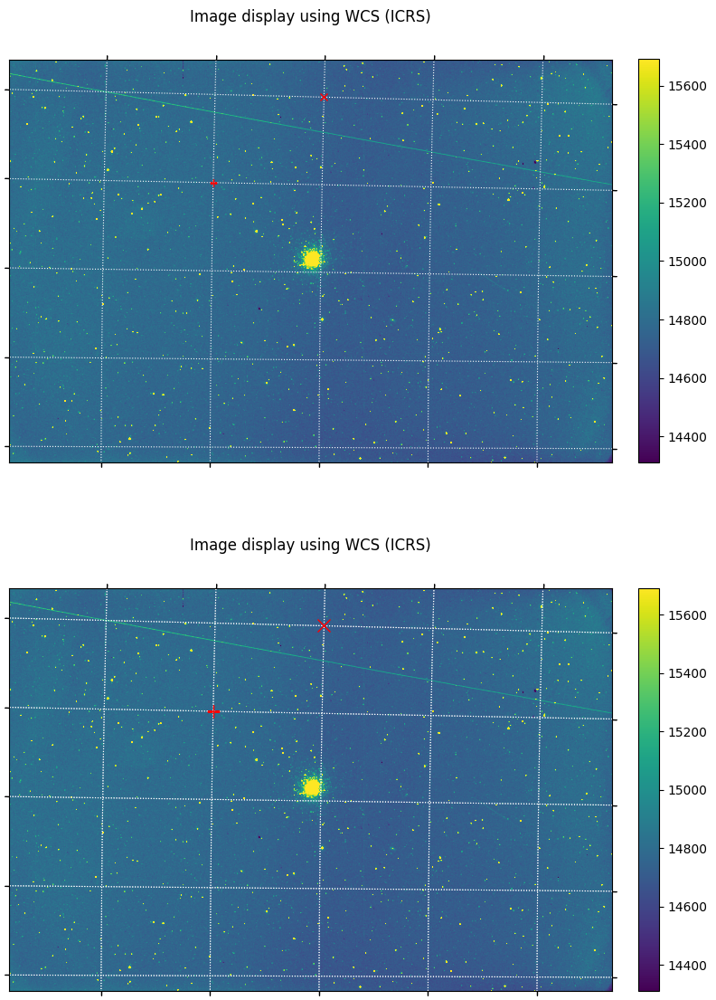

dir(axs[0].coords) : ['__class__', '__contains__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getitem__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__iter__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_aliases', '_as_table', '_axes', '_coords', '_transform', 'frame', 'get_coord_range', 'grid', 'set_visible']
axs[0].coords.set_visible : <bound method CoordinatesMap.set_visible of <CoordinatesMap with 2 world coordinates:

  index         aliases            type   unit    wrap   format_unit visible
  ----- ----------------------- --------- ---- --------- ----------- -------
      0   pos.eq.ra ra---tan ra longitude  deg 360.0 deg   hourangle     yes
      1 pos.eq.dec dec--tan dec  latitude  deg      None         deg     yes

>>
axs[0].coords.frame : RectangularFrame

In [35]:
fig, axs = plt.subplots(2, 1, figsize=(8, 12),
                        sharex=False, sharey=False, gridspec_kw=None,
                        subplot_kw={'projection': wcs2},
                        )

im0 = zimshow(axs[0], hdul2[0].data,
                origin='lower',
                cmap="viridis",
                )

axs[0].coords['ra'].set_ticklabel_position('b') #left, right, bottom, top
axs[0].coords['dec'].set_ticklabel_position('l') #left, right, bottom, top
axs[0].plot_coord(SkyCoord(249.5*u.deg, 36.5*u.deg, frame="icrs"), "rx")
axs[0].plot_coord(SkyCoord(250*u.deg, 36*u.deg, frame="icrs"), "r+")

overlay0 = axs[0].get_coords_overlay('icrs')
overlay0.grid(color='white', ls='dotted')
overlay0[0].set_axislabel('Right Ascension', minpad=2)
overlay0[1].set_axislabel('Declination', minpad=2)
overlay0[0].set_axislabel_position('b')
overlay0[1].set_axislabel_position('l')
overlay0[0].set_ticklabel_position('b') #left, right, bottom, top
overlay0[1].set_ticklabel_position('l') #left, right, bottom, top
axs[0].set_title('Image display using WCS (ICRS)', fontsize=12, pad=30)

im1 = zimshow(axs[1], hdul2[0].data,
                origin='lower',
                cmap="viridis",
                )

# axs[1].coords['ra'].set_axislabel('Right Ascension (J2000.0)')
# axs[1].coords['dec'].set_axislabel('Declination (J2000.0)')
# axs[1].coords['ra'].set_axislabel_position('b') #left, right, bottom, top
# axs[1].coords['dec'].set_axislabel_position('l') #left, right, bottom, top
axs[1].coords['ra'].set_ticklabel_position('b') #left, right, bottom, top
axs[1].coords['dec'].set_ticklabel_position('l') #left, right, bottom, top
axs[1].grid(color='white', ls=':')

axs[1].plot_coord(SkyCoord(249.5*u.deg, 36.5*u.deg, frame="fk5"), "rx", markersize=10)
axs[1].plot_coord(SkyCoord(250*u.deg, 36*u.deg, frame="fk5"), "r+", markersize=10)

overlay1 = axs[1].get_coords_overlay('fk5')
overlay1.grid(color='white', ls='dotted')
overlay1[0].set_axislabel('Right Ascension (J2000.0)', minpad=2)
overlay1[1].set_axislabel('Declination (J2000.0)', minpad=2)
overlay1[0].set_axislabel_position('b')
overlay1[1].set_axislabel_position('l')
overlay1[0].set_ticklabel_position('b') #left, right, bottom, top
overlay1[1].set_ticklabel_position('l') #left, right, bottom, top

axs[1].set_title('Image display using WCS (ICRS)', fontsize=12, pad=30)

fig.colorbar(im0, ax = axs[0], fraction=0.031, pad=0.04)
fig.colorbar(im1, ax = axs[1], fraction=0.031, pad=0.04)

plt.tight_layout(pad=1.0, w_pad=1.0, h_pad=1.0)
plt.show()

plt.show()

print("dir(axs[0].coords) :", dir(axs[0].coords))
# print("axs[0].coords.get_coord_range :", axs[0].coords.get_coord_range)
print("axs[0].coords.set_visible :", axs[0].coords.set_visible)
print("axs[0].coords.frame :", axs[0].coords.frame)

print("dir(axs[1].coords) :", dir(axs[1].coords))
# print("axs[1].coords.get_coord_range :", axs[1].coords.get_coord_range)
print("axs[1].coords.set_visible :", axs[1].coords.set_visible)
print("axs[1].coords.frame :", axs[1].coords.frame)

###(과제)

앞에서 plate solving 한 파일을 WCS를 이용하여 display 하시오.

In [36]:
#(과제) 아래 코딩을 완성하여 제출하시오.





